In [2]:
import pypsa
import openpyxl
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import matplotlib.patches as mpatches

In [3]:
tech_colors= {
    'onwind': "#235ebc",
    'onshore wind': "#235ebc",
    'offwind': "#6895dd",
    'offshore wind': "#6895dd",
    'offwind-ac': "#6895dd",
    'offshore wind (AC)': "#6895dd",
    'offwind-dc': "#74c6f2",
    'offshore wind (DC)': "#74c6f2",
    'hydro': '#298c81',
    'hydro reservoir': '#298c81',
    'ror': '#3dbfb0',
    'run of river': '#3dbfb0',
    'hydroelectricity': '#298c81',
    'PHS': '#51dbcc',
    'wave': '#a7d4cf',
    'solar': "#f9d002",
    'solar utility': "#f9d002",
    'solar PV': "#f9d002",
    'solar thermal': '#ffbf2b',
    'solar rooftop': 'orange',
        'solar distributed': 'orange',
    'OCGT': '#e0986c',
    'gas': '#e05b09',
    'fossil gas': '#e05b09',
    'natural gas': '#e05b09',
    'CCGT': '#a85522',
    'Nuclear': '#ff8c00',
    'Nuclear marginal': '#ff8c00',
    'nuclear': 'brown',
    'uranium': '#ff8c00',
    'battery discharger': '#ace37f',
    'utility battery charger': '#ace37f',
    'battery charger': '#ace37f',
    'utility battery discharger': '#ace37f',
    'home battery charger': '#80c944',
    'home battery discharger': '#80c944',
    'distributed battery charger': '#80c944',
    'distributed battery discharger': '#80c944',
    'hydrogen': '#bf13a0',
    'SMR': '#870c71',
    'SMR CC': '#4f1745',
    'H2 Fuel Cell': '#c251ae',
    'H2 Electrolysis': '#ff29d9',
    'electricity distribution grid': 'grey',
    'electricity': 'black',
    'hydrogen': 'red',
    'methane' : '#870c71',
     'oil' : '#a7d4cf',
    'p_nom_opt' : '#870c71',
     'p_nom_max' : '#a7d4cf',
    'transmission' : 'darkgrey',
    'other high voltage' :'grey',

    
}

In [4]:
def get_energy_production (n, s, e , energy_type ,exclude_list, country) :
     gen_list=['onwind', 'offwind','solar','solar rooftop', 'ror']
     link_list=['home battery discharger','battery discharger','H2 Fuel Cell','nuclear','CCGT','OCGT']
     storage_list=['PHS','hydro']
     if energy_type is not 'all':
        if energy_type is 'distributed':
            exclude_list.extend(['solar', 'onwind', 'offwind', 'ror','nuclear','battery discharger','H2 Fuel Cell',
                                 'PHS', 'hydro','CCGT','OCGT'])
        if energy_type is 'utility':
            exclude_list.extend(['solar rooftop', 'home battery discharger'])    
     temp={}
     for k in gen_list:
        if k is 'offwind' : 
          elec = n.generators[n.generators.carrier.isin(['offwind-ac','offwind-dc'])].index 
        else :
          elec = n.generators[n.generators.carrier.isin([k])].index
        temp[k]=2*(n.generators_t.p[elec][s:e].filter(like=country).sum(axis=1)/1e3)   #GWh
     for k in link_list:
          elec = n.links[n.links.carrier.isin([k])].index
          temp[k]=2*((-1)*n.links_t.p1[elec][s:e].filter(like=country).sum(axis=1)/1e3)   #GWh
     for k in storage_list:
          elec = n.storage_units[n.storage_units.carrier.isin([k])].index
          temp[k]=2*(n.storage_units_t.p[elec][s:e].filter(like=country).sum(axis=1)/1e3)  #GWh
          temp[k] = temp[k].clip(lower=0)    #only PHS discharging
            
     #temp['PHS discharge'] = temp.pop('PHS')  
     temp['run of river'] = temp.pop('ror')              
     temp['utility battery discharger'] = temp.pop('battery discharger')              
     temp['home battery discharger'] = temp.pop('home battery discharger')              
     temp['solar utility'] = temp.pop('solar')  
     temp['solar distributed'] = temp.pop('solar rooftop')  

    
     colors=[]
     for key in temp.keys() : 
        colors.append(tech_colors[key])
     return temp, colors

<>:5: SyntaxWarning: "is not" with a literal. Did you mean "!="?
<>:6: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:9: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:13: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:5: SyntaxWarning: "is not" with a literal. Did you mean "!="?
<>:6: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:9: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:13: SyntaxWarning: "is" with a literal. Did you mean "=="?
/tmp/ipykernel_11822/4083431915.py:5: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if energy_type is not 'all':
/tmp/ipykernel_11822/4083431915.py:6: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if energy_type is 'distributed':
/tmp/ipykernel_11822/4083431915.py:9: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if energy_type is 'utility':
/tmp/ipykernel_11822/4083431915.py:13: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if k is 'offwind' :


In [5]:
def get_energy_usage (n, s, e , energy_type ,exclude_list, country) :
     link_list=('home battery charger','battery charger','H2 Electrolysis')
     storage_list=['PHS']
     if energy_type is not 'all':
        if energy_type is 'distributed':
            exclude_list.extend(['solar', 'onwind', 'offwind', 'ror','nuclear','battery charger','H2 Electrolysis',
                                 'PHS', 'hydro','CCGT','OCGT'])
        if energy_type is 'utility':
            exclude_list.extend(['solar rooftop', 'home battery charger'])    
     temp={}
     
     for k in link_list:
        if k not in exclude_list:  
          elec = n.links[n.links.carrier.isin([k])].index
          temp[k]=2*((-1)*n.links_t.p0[elec][s:e].filter(like=country).sum(axis=1)/1e3)   #GWh
            
     for k in storage_list:
          elec = n.storage_units[n.storage_units.carrier.isin([k])].index
          temp[k]=(-2)*(n.storage_units_t.p[elec][s:e].filter(like=country).sum(axis=1)/1e3)  #GWh
          temp[k] = temp[k].clip(lower=0)    #for PHS charging
          temp[k] = (-1)*temp[k]
        
     temp['utility battery charger'] = temp.pop('battery charger')              
     temp['home battery charger'] = temp.pop('home battery charger')              

     colors=[]
     for key in temp.keys() : 
        colors.append(tech_colors[key])
        
   
     return temp, colors

<>:4: SyntaxWarning: "is not" with a literal. Did you mean "!="?
<>:5: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:8: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:4: SyntaxWarning: "is not" with a literal. Did you mean "!="?
<>:5: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:8: SyntaxWarning: "is" with a literal. Did you mean "=="?
/tmp/ipykernel_11822/2311001093.py:4: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if energy_type is not 'all':
/tmp/ipykernel_11822/2311001093.py:5: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if energy_type is 'distributed':
/tmp/ipykernel_11822/2311001093.py:8: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if energy_type is 'utility':


In [10]:
def generation(n, carriers=None):

    dispatch = n.generators_t.p 

    generation = n.snapshot_weightings.generators @ (dispatch) #n.snapshot_weightings.generators

    generation = (
        generation.groupby([n.generators.bus.map(n.buses.location), n.generators.carrier])
        .sum()
        .unstack()
    )
    
    links_gen= (-1) *n.snapshot_weightings.generators @(n.links_t.p1)
    links_gen = (links_gen.groupby([n.links.bus1.map(n.buses.location), n.links.carrier])
        .sum()
        .unstack()
    )
    for i in links_gen['nuclear'].index:
      if 'EU' not in i :  
            generation.loc[ ( i, "nuclear" ) ]=links_gen['nuclear'].loc[i]

    if carriers is not None:
        generation = generation[carriers]

    return generation.drop("EU", axis=0).stack().div(1e6)

carriers = {
        "offwind-ac": "Offshore Wind (AC)",
        "offwind-dc": "Offshore Wind (DC)",
        "onwind": "Onshore Wind",
        "ror": "Run of River",
        "solar": "Utility-scale Solar PV",
        "solar rooftop": "Rooftop Solar PV",
        "nuclear" : 'Nuclear'
    }

#gen = generation(n, carriers.keys())

In [19]:
# figure S12, S13, S14, S15
import cartopy.crs as ccrs
import cartopy
import geopandas as gpd

epsg = 3035
nodes = gpd.read_file('regions_onshore_elec_s_181.geojson').set_index("name")
nodes["Area"] = nodes.to_crs(epsg=epsg).area.div(1e6)
n=pypsa.Network('postnetworks/elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist1-higheff_2030.nc')
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)
gen = generation(n, carriers.keys())
#europe_shape = nodes.dissolve()
#europe_shape.index = ["EU"]
#minx, miny, maxx, maxy = europe_shape.explode(ignore_index=True).total_bounds
#BOUNDARIES = [minx, maxx - 4, miny, maxy]
fig,axs = plt.subplots(figsize=(10,10) , subplot_kw={"projection":ccrs.PlateCarree()})   #or  ccrs.Orthographic() .Mercator

line_width_factor=10
bus_size_factor=75

n.plot (ax=axs,
        bus_colors=tech_colors,
        branch_components=["Line"],
        line_widths=n.lines.s_nom_opt/(1e3*line_width_factor),  #GW
        line_colors=loading,
        geomap=True,
        bus_sizes=gen/(bus_size_factor))  #GWh

axs.axis('off')
axs.set_extent([-10.53, 28.8, 35, 70])
axs.set_title('Scenario A', fontsize=20)

sizes = [25, 50]
labels = [f"{s} TWh" for s in sizes]
add_legend_circles(
        axs,
        sizes,
        labels,
        scale=bus_size_factor,
        srid=n.srid,
        legend_kw=dict(title="Energy generation", loc="upper left",fontsize=14, frameon=False),
        patch_kw=dict(facecolor="lightgrey",),
    )

sizes = [10, 20]
labels = [f"{s} GW" for s in sizes]
add_legend_lines(
        axs,
        sizes,
        labels,
        scale=line_width_factor ,
        legend_kw=dict(title="Line Capacity", bbox_to_anchor=(0.5, 1),fontsize=12,frameon=False),
        patch_kw=dict(color="lightgrey"),
    )

colors = [tech_colors[c] for c in carriers.keys()]
labels=[i for i in carriers.keys()]
add_legend_patch(
        axs,
        colors,
        labels,
        patch_kw=dict(edgecolor="None"),
        legend_kw=dict(bbox_to_anchor=(0.5, 1.2), ncol=2,fontsize=14,frameon=False),)

INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist1-higheff_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


In [5]:
def get_energy_production (n, energy_type ,exclude_list, country) :
     gen_list=( 'onwind', 'offwind','solar','solar rooftop', 'ror')
     link_list=('home battery discharger','battery discharger','H2 Fuel Cell','H2 Electrolysis','nuclear','CCGT','OCGT')
     storage_list=('PHS', 'hydro')
     if energy_type is not 'all':
        if energy_type is 'distributed':
            exclude_list.extend(['solar', 'onwind', 'offwind', 'ror','nuclear','battery discharger','H2 Fuel Cell',
                                 'PHS', 'hydro','CCGT','OCGT'])
        if energy_type is 'utility':
            exclude_list.extend(['solar rooftop', 'home battery discharger'])    
     temp=pd.DataFrame({})
     for k in gen_list:
      if k not in exclude_list:  
        if k is 'offwind' : 
         elec = n.generators[n.generators.carrier.isin(['offwind-ac','offwind-dc'])].index 
        else :
         elec = n.generators[n.generators.carrier.isin([k])].index
        temp[k]=2*(n.generators_t.p[elec].filter(like=str(country)+' ').sum(axis=1))   #MWh
     for k in link_list:
       if k not in exclude_list:  
         if 'Electrolysis' not in k:   
          elec = n.links[n.links.carrier.isin([k])].index
          temp[k]=2*((-1)*n.links_t.p1[elec].filter(like=str(country)+' ').sum(axis=1))   #MWh
         else:   
          elec = n.links[n.links.carrier.isin([k])].index
          temp[k]=2*((-1)*n.links_t.p0[elec].filter(like=str(country)+' ').sum(axis=1))   #MWh   
     for k in storage_list:
        if k not in exclude_list:  
          elec = n.storage_units[n.storage_units.carrier.isin([k])].index
          temp[k]=2*(n.storage_units_t.p[elec].filter(like=str(country)+' ').sum(axis=1))  #MWh
            
     temp['transmission'] = (2*((-1)*n.lines_t.p0[[i for i in n.lines.index if (country) in n.lines.bus0[i] ]].sum(axis=1) +
                (-1)*n.lines_t.p1[[i for i in n.lines.index if (country) in n.lines.bus1[i]]].sum(axis=1) )+
                   2*((-1)*n.links_t.p0[[i for i in n.links.index if (country) in n.links.bus0[i] and 
                      n.links.carrier[i]=='DC']].sum(axis=1) +
               (-1)*n.links_t.p1[[i for i in n.links.index if (country) in n.links.bus1[i]
                                 and n.links.carrier[i]=='DC' ]].sum(axis=1))) #MWh  #MWh

     colors=[]
     for key in temp.keys() : 
        colors.append(tech_colors[key])
     return temp, colors

<>:5: SyntaxWarning: "is not" with a literal. Did you mean "!="?
<>:6: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:9: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:14: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:5: SyntaxWarning: "is not" with a literal. Did you mean "!="?
<>:6: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:9: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:14: SyntaxWarning: "is" with a literal. Did you mean "=="?
/tmp/ipykernel_28911/259421475.py:5: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if energy_type is not 'all':
/tmp/ipykernel_28911/259421475.py:6: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if energy_type is 'distributed':
/tmp/ipykernel_28911/259421475.py:9: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if energy_type is 'utility':
/tmp/ipykernel_28911/259421475.py:14: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if k is 'offwind' :


In [12]:
from pypsa.plot import projected_area_factor
from matplotlib.patches import Circle, Ellipse, Patch
from matplotlib.legend_handler import HandlerPatch
from matplotlib.lines import Line2D

class HandlerCircle(HandlerPatch):
    """
    Legend Handler used to create circles for legend entries.

    This handler resizes the circles in order to match the same dimensional
    scaling as in the applied axis.
    """

    def create_artists(
        self, legend, orig_handle, xdescent, ydescent, width, height, fontsize, trans
    ):
        fig = legend.get_figure()
        ax = legend.axes

        unit = np.diff(ax.transData.transform([(0, 0), (1, 1)]), axis=0)[0][1]
        radius = orig_handle.get_radius() * unit * (72 / fig.dpi)
        center = 5 - xdescent, 3 - ydescent
        p = plt.Circle(center, radius)
        self.update_prop(p, orig_handle, legend)
        p.set_transform(trans)
        return [p]


def make_legend_circles_for(sizes, scale=1.0, **kw):
    return [Circle((0, 0), radius=(s / scale)**0.5, **kw) for s in sizes]

def add_legend_circles(
    ax, sizes, labels, scale=1, srid=None, patch_kw={}, legend_kw={}
):

    if srid is not None:
        area_correction = projected_area_factor(ax, n.srid) ** 2
        sizes = [s * area_correction for s in sizes]

    handles = make_legend_circles_for(sizes, scale, **patch_kw)

    legend = ax.legend(
        handles, labels, handler_map={Circle: HandlerCircle()}, **legend_kw
    )

    ax.add_artist(legend)


def add_legend_lines(ax, sizes, labels, scale=1, patch_kw={}, legend_kw={}):

    handles = [Line2D([0], [0], linewidth=s / scale, **patch_kw) for s in sizes]

    legend = ax.legend(handles, labels, **legend_kw)

    ax.add_artist(legend)


def add_legend_patch(ax, colors, labels, patch_kw={}, legend_kw={}):

    handles = [Patch(facecolor=c, **patch_kw) for c in colors]

    legend = ax.legend(handles, labels, **legend_kw)

    ax.add_artist(legend)

INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist2_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/pypsa/plot.py:252: RuntimeWarning: invalid value encountered in double_scalars
  radius = s.sum() ** 0.5
/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/cartopy/crs.py:825: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/cartopy/crs.py:877: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_st

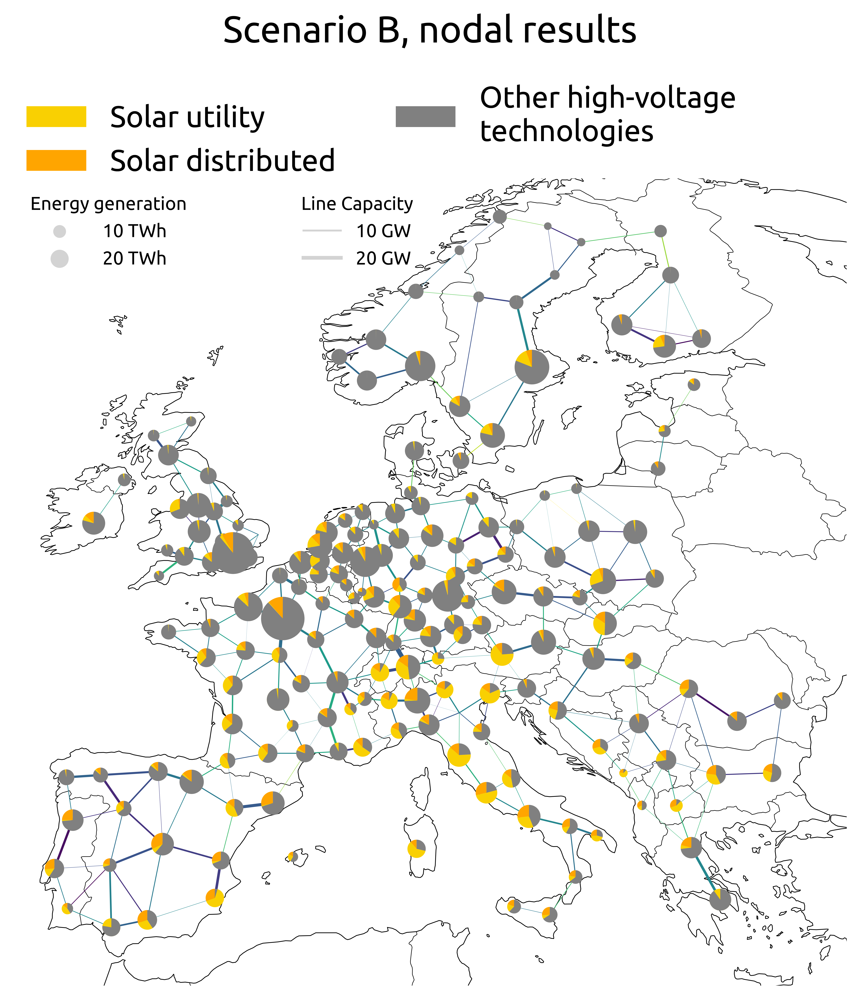

In [7]:
#figure 5
# FINAL FIGURE: added time dependance of solar transmission share

#The assumptions made : rooftop contribution to high voltage is negligable, and distribution
# grid flow is always downwards for the annual sum (easily checked n.links_t.p0.filter(like='distribution grid').sum(axis=0).all() >0 )
#  and storage annual sum is zer (except for some power loss between charge and discharge) 
#so rooftop share is it's own, when there is transmission imports it's also part of the high-voltage-techs,
#when there is transmission exports the sum is divided betwwen solar and other technologies based on their share of local production
# ATTENTION : all energy production is positive, transmission is negative if exported and positive if imported
import cartopy.crs as ccrs

plt.rcParams['figure.dpi'] = 1000
plt.rc('font',family='Ubuntu')

proj = ccrs.EqualEarth()
fig, axs = plt.subplots(figsize=(8, 8), subplot_kw={"projection": proj},sharex=True, sharey=True) 
bus_size_factor=1e2
line_width_factor=10

dist_gen={}
dist_gen_ex={}

n=pypsa.Network('postnetworks/elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist2_2030.nc')


loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)
for bus in n.buses.index:
       if n.buses.carrier[bus]=='AC' :
        energy_production, colors=get_energy_production(n,  'all', ['battery discharger', 'home battery discharger'],
                                                bus) 
        energy_production['local production']=energy_production.drop([i for i in energy_production.columns if 'transmission' in i]
                                                             , axis=1, inplace=False).sum(axis=1)
        energy_production['solar_exported']=(-1)*(energy_production['transmission']         ##exported solar energy
                                                  [energy_production['transmission']<0]*energy_production['solar']/
                                                  energy_production['local production'])
        energy_production=energy_production.fillna(0)
        energy_production['other_techs']=(energy_production.drop(
            ['solar','local production','solar rooftop','solar_exported','transmission']
                           , axis=1, inplace=False).sum(axis=1) + 
                                          energy_production['transmission'].clip(0))  ## all other high tech+
                                                                                         ##transmission imports

        energy_production['other_exported']=((-1)*energy_production['transmission']    
                                                  [energy_production['transmission']<0]-
                                                energy_production['solar_exported']) 
        energy_production=energy_production.fillna(0)
        energy_production['highv_other']=energy_production['other_techs']-energy_production['other_exported']##other high voltage genration
                                                                                                # minus their share of export
        
        
        dist_gen[(bus,'solar rooftop')]= energy_production['solar rooftop'].sum() 
        dist_gen_ex[(bus,'demand')]= 2*n.loads_t.p_set[bus].sum().sum()
        dist_gen_ex[(bus,'electricity distribution grid')]=2*(n.links_t.p0.filter(like='distribution grid').filter(like=str(bus)+' ')
              [n.links_t.p0.filter(like='distribution grid').filter(like=str(bus)+' ')>0]).sum().sum() 
            
        dist_gen[(bus,'solar')]= energy_production['solar'].sum()-energy_production['solar_exported'].sum()
        dist_gen[(bus,'other high voltage')]=energy_production['highv_other'].sum()     
        

            
dist_gen_series = pd.Series(dist_gen)/1e6 #TWh
dist_gen_series_ex = pd.Series(dist_gen_ex)/1e6 #TWh
bus_sizes =dist_gen_series   #_short

n.plot (ax=axs,
        bus_colors=tech_colors,
        branch_components=["Line"],
        line_widths=n.lines.s_nom_opt/(1e3*line_width_factor),  #GW
        line_colors=loading,
        geomap=True,
        bus_sizes=bus_sizes/bus_size_factor)
    
axs.axis('off')
axs.set_extent([-10.53, 28.8, 35, 70])
axs.set_title('Scenario B, nodal results\n\n\n', fontsize=20)

sizes = [10, 20]
labels = [f"{s} TWh" for s in sizes]
add_legend_circles(
        axs,
        sizes,
        labels,
        scale=bus_size_factor,
        srid=n.srid,
        legend_kw=dict(title="Energy generation", loc="upper left",fontsize=10, frameon=False),
        patch_kw=dict(facecolor="lightgrey",),
    )

sizes = [10, 20]
labels = [f"{s} GW" for s in sizes]
add_legend_lines(
        axs,
        sizes,
        labels,
        scale=line_width_factor ,
        legend_kw=dict(title="Line Capacity", bbox_to_anchor=(0.5, 1),fontsize=10,frameon=False),
        patch_kw=dict(color="lightgrey"),
    )

carriers=['solar','solar rooftop',  'other high voltage',]
labels=['Solar utility','Solar distributed', 'Other high-voltage\ntechnologies']
colors = [tech_colors[c] for c in carriers]
add_legend_patch(
        axs,
        colors,
        labels,
        patch_kw=dict(edgecolor="None"),
        legend_kw=dict(bbox_to_anchor=(0.9, 1.15), ncol=2,fontsize=16,frameon=False),)
#plt.savefig('genmaptest.png', dpi=300)


#are the lines needed? check the calculation

INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist2_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/cartopy/crs.py:825: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/cartopy/crs.py:877: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/home/parisr/miniconda3/envs/pypsa-eur2/lib/python3.9/site-packages/cartopy/crs.py:944: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and 

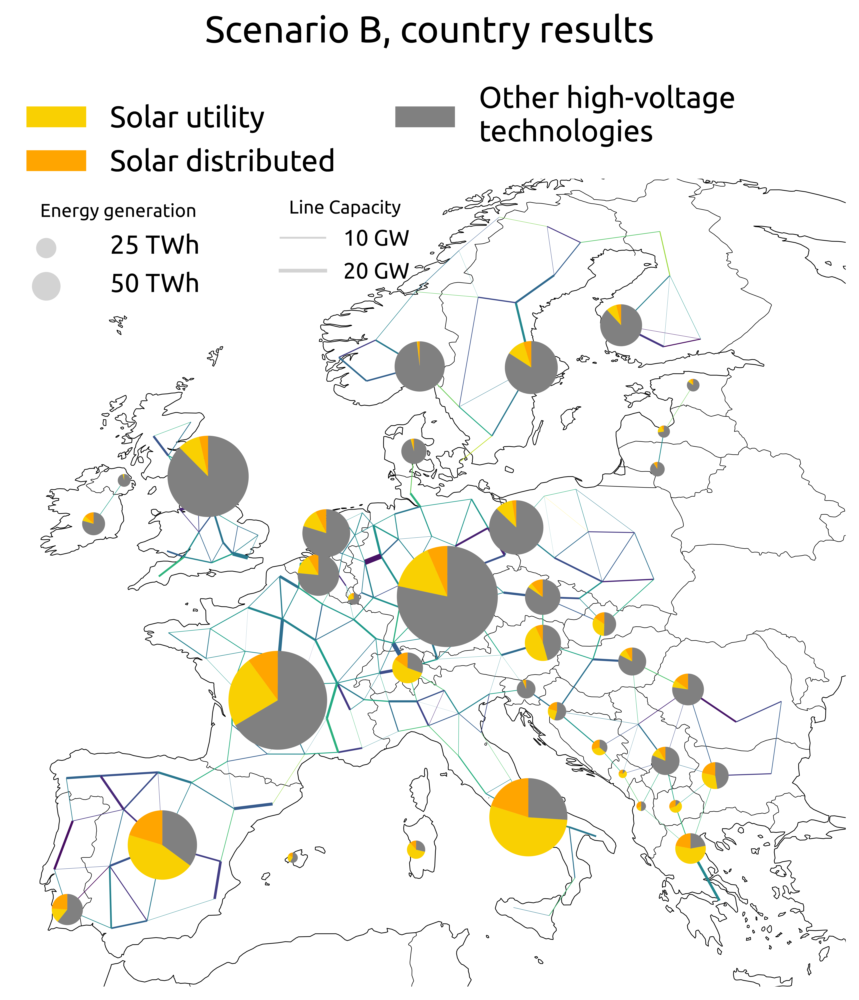

In [8]:
# FINAL FIGURE: added time dependance of solar transmission share

import cartopy.crs as ccrs

plt.rcParams['figure.dpi'] = 1000
plt.rc('font',family='Ubuntu')

proj = ccrs.EqualEarth()
fig, axs = plt.subplots(figsize=(8, 8), subplot_kw={"projection": proj},sharex=True, sharey=True) 
bus_size_factor=1e2
line_width_factor=10

dist_gen={}
n=pypsa.Network('postnetworks/elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist2_2030.nc')


loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)
for bus in n.buses.index:
       if n.buses.carrier[bus]=='AC' :
        bus=bus[:3]
        energy_production, colors=get_energy_production(n,  'all', ['battery discharger', 'home battery discharger'],
                                                bus) 
        energy_production['local production']=energy_production.drop([i for i in energy_production.columns if 'transmission' in i]
                                                             , axis=1, inplace=False).sum(axis=1)
        energy_production['solar_exported']=(-1)*(energy_production['transmission']         ##exported solar energy
                                                  [energy_production['transmission']<0]*energy_production['solar']/
                                                  energy_production['local production'])
        energy_production=energy_production.fillna(0)
        energy_production['other_techs']=(energy_production.drop(
            ['solar','local production','solar rooftop','solar_exported','transmission']
                           , axis=1, inplace=False).sum(axis=1) + 
                                          energy_production['transmission'].clip(0))  ## all other high tech+
                                                                                         ##transmission imports

        energy_production['other_exported']=((-1)*energy_production['transmission']    
                                                  [energy_production['transmission']<0]-
                                                energy_production['solar_exported']) 
        energy_production=energy_production.fillna(0)
        energy_production['highv_other']=energy_production['other_techs']-energy_production['other_exported']##other high voltage genration
                                                                                                # minus their share of export
        
        
        dist_gen[(bus,'solar rooftop')]= energy_production['solar rooftop'].sum() 
        #dist_gen_ex[(bus,'demand')]= 2*n.loads_t.p_set[bus].sum().sum()
        #dist_gen_ex[(bus,'electricity distribution grid')]=2*(n.links_t.p0.filter(like='distribution grid').filter(like=str(bus)+' ')
         #     [n.links_t.p0.filter(like='distribution grid').filter(like=str(bus)+' ')>0]).sum().sum() 
            
        dist_gen[(bus,'solar')]= energy_production['solar'].sum()-energy_production['solar_exported'].sum()
        dist_gen[(bus,'other high voltage')]=energy_production['highv_other'].sum()  

        
##merge 2 denmark nodes        
dist_gen_series = pd.Series(dist_gen)/1e6 #TWh
for i in dist_gen_series.filter(like='DK1').index.get_level_values(1):
   dist_gen_series[('DK1',i )]= dist_gen_series[('DK1',i )]+dist_gen_series[('DK2',i )]
dist_gen_series=dist_gen_series.drop('DK2', level=0)

bus_sizes =dist_gen_series
bus_sizes.rename(index=lambda x: x +" 0", level=0, inplace=True)
    
bus_sizes.rename(index=lambda x: x.replace("FR1 0","FR1 2"), level=0, inplace=True)
bus_sizes.rename(index=lambda x: x.replace("DE1 0","DE1 2"), level=0, inplace=True)
bus_sizes.rename(index=lambda x: x.replace("IT1 0","IT1 2"), level=0, inplace=True)
bus_sizes.rename(index=lambda x: x.replace("ES1 0","ES1 1"), level=0, inplace=True) #11
bus_sizes.rename(index=lambda x: x.replace("AT1 0","AT1 1"), level=0, inplace=True)
bus_sizes.rename(index=lambda x: x.replace("GB0 0","GB0 8"), level=0, inplace=True)
bus_sizes.rename(index=lambda x: x.replace("CZ1 0","CZ1 1"), level=0, inplace=True)

n.plot (ax=axs,
        bus_colors=tech_colors,
        branch_components=["Line"],
        line_widths=n.lines.s_nom_opt/(1e3*line_width_factor),  #GW
        line_colors=loading,
        geomap=True,
        bus_sizes=bus_sizes/bus_size_factor)
    
axs.axis('off')
axs.set_extent([-10.53, 28.8, 35, 70])
axs.set_title('Scenario B, country results\n\n\n', fontsize=20)

sizes = [25, 50]
labels = [f"{s} TWh" for s in sizes]
add_legend_circles(
        axs,
        sizes,
        labels,
        scale=bus_size_factor,
        srid=n.srid,
        legend_kw=dict(title="Energy generation", loc="upper left",fontsize=14, frameon=False),
        patch_kw=dict(facecolor="lightgrey",),
    )

sizes = [10, 20]
labels = [f"{s} GW" for s in sizes]
add_legend_lines(
        axs,
        sizes,
        labels,
        scale=line_width_factor ,
        legend_kw=dict(title="Line Capacity", bbox_to_anchor=(0.5, 1),fontsize=12,frameon=False),
        patch_kw=dict(color="lightgrey"),
    )

carriers=['solar','solar rooftop',  'other high voltage',]
labels=['Solar utility','Solar distributed', 'Other high-voltage\ntechnologies']
colors = [tech_colors[c] for c in carriers]
add_legend_patch(
        axs,
        colors,
        labels,
        patch_kw=dict(edgecolor="None"),
        legend_kw=dict(bbox_to_anchor=(0.9, 1.15), ncol=2,fontsize=16,frameon=False),)
#plt.savefig('genmaptest.png', dpi=300)


#are the lines needed? check the calculation

In [7]:
# figure 5, S9 , S10 , S11
import matplotlib.dates as mdates

fig, axs = plt.subplots(2,2, figsize=(12,8), sharey=True) 
plt.subplots_adjust(wspace=0.05)
plt.subplots_adjust(hspace=0.1)

s=[194*12, 14*12]
e=[201*12, 21*12]

plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')
plt.rcParams['figure.dpi'] = 1000

networks={'postnetworks/elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist1-nohomegen-higheff_2030.nc':'Without distributed generation',
          'postnetworks/elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist1-higheff_2030.nc':'With distributed generation',}
date_form = mdates.DateFormatter('%m-%d')

country='DE'  #'IT' , ' '

for i,network in enumerate(networks.keys()):
  n=pypsa.Network(network)
  for j,season in enumerate(['summer week','winter week']):
    energy_production, colors=get_energy_production(n, s[j] , e[j], 'all', [], country)  
    energy_usage, colors_2=get_energy_usage(n, s[j] , e[j], 'all', [], country)  
    colors.extend(colors_2)
    
    axs[i,j].set_prop_cycle(color=colors)
    #seperate battery and home battery
    axs[i,j].stackplot(n.snapshots[s[j]:e[j]],energy_production.values(),
                       labels=energy_production.keys())   #GWh
    axs[i,j].stackplot(n.snapshots[s[j]:e[j]],energy_usage.values(),
                       labels=energy_usage.keys())
    axs[i,j].plot(2*n.loads_t.p.filter(like=country).sum(axis=1)[s[j]:e[j]]/1e3,
                  color='black'
                 ,label='electricity demand'
                 ,linewidth=3)
    hightolow=2*((-1)*n.links_t.p1.filter(like=country).filter(like='distribution grid')
              [n.links_t.p1.filter(like=country).filter(like='distribution grid')<0])[s[j]:e[j]].sum(axis=1)/1e3
    axs[i,j].plot(hightolow,
                  color='red',
                  label= 'LV electricity demand',
                  linewidth=3)
    axs[i,j].fill_between(n.snapshots[s[j]:e[j]], 0, hightolow, 
                          facecolor='grey', 
                          interpolate=True, 
                          alpha=.7)
    axs[i,j].tick_params(axis='y', labelsize=20)
    if i==0 :axs[i,j].set_xticks([], []) 
    if i==1 :
        axs[i,j].xaxis.set_major_locator(mdates.DayLocator(interval=1))
        axs[i,j].xaxis.set_major_formatter(date_form)
        for label in axs[i,j].get_xticklabels(which='major'):
            label.set(rotation=45, fontsize= 16, rotation_mode='anchor',ha='right')
        axs[i,j].set_xlabel("\ndays",fontsize= 18)
    if i==0: axs[i,j].set_title(season+'\n', fontsize=18)
    if j==0: axs[i,j].set_ylabel(networks[network]+'\n\n'+'Energy generation [GWh]',fontsize=14, 
                                 fontname = 'Ubuntu',labelpad=10)
    handles, labels = axs[i,j].get_legend_handles_labels()


#
plt.legend(handles[::-1], labels[::-1], loc='upper left', bbox_to_anchor=(1, 2),ncol=1,
           fontsize=12,frameon=False)   



fig.text(0, 0.4, "Scenario A\n", 
         fontsize=14, rotation=90, rotation_mode='anchor')

#plt.savefig('figure 5b.pdf', dpi=1000)

INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist1-nohomegen-higheff_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s_181_lv1.1__Co2L0p05-2H-solar+p3-dist1-higheff_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


Text(0, 0.4, 'Scenario A\n')